**Lab 4: FIR filters and envelopes**

The goal of this lab is to learn how to implement FIR filters in Python, and how we can use them to improve our synthesis.

In [ ]:
!git clone https://github.com/pzinemanas/sis1lab.git

import os
import numpy as np
import librosa
import IPython.display as ipd
from scipy import signal
import matplotlib.pyplot as plt

from sis1lab.util import load_audio, plot_signals, plot_spectrogram, plot_mean_spectrogram

fatal: destination path 'sis1lab' already exists and is not an empty directory.


**1. Overview of Filtering**

For this lab, we will define an FIR filter as a discrete-time system that converts an input signal $x[n]$ into an output signal $y[n]$ by means of the weighted summation:

$$
y[n] = \sum_{k=0}^M b_kx[n-k]
$$

The function *np.convolve()* is a generic function with which to implement FIR filters. The following code implements a three-point averaging system:

In [ ]:
fs = 1
x = [np.floor(x/10) for x in range(50)]
b = np.array([1.0/3, 1.0/3, 1.0/3])
y = np.convolve(b, x)

plot_signals([x, y], fs, name=['input x[n]', 'output y[n]'], mode='lines+markers')

1.1 Explain the filtering action of the 3-point averager by comparing the plot of the input $x[n]$ and the output $y[n]$. This filter might be called a “smoothing” filter. Note how the transitions from one level to another have been “smoothed.”

The filter takes 3 values/samples of $x[n]$, multiplies each one of them with the respective values of $b_k$ and sums the result. As a result, whenever the amplitude of the signal changes abruptly, the output is smoothed. The coefficients of $b_k$ in this case are 1/3, because we are averaging each sample of $x[n]$ with the previous two samples.

1.2 Define a function `averaging_filter(x, N)` which implements the N-points averaging filter using the `np.convolve` function.

In [ ]:
   """Applies a N-point averaging filter to the input signal x

   Parameters
   ----------
    x : np.array
        The input signal in the form of a numpy array
    N : int
        The number of points used in N-point averaging filter

    Returns
    -------
    y : np.array
        The output of the filter

   """

def averaging_filter(x, N, mode):
  b_k = [1/N]*N
  y = np.convolve(b_k, x, mode)
  return y

1.3 Run the example below using the `averaging_filter` instead. Change the number N and explain what happen.

In [ ]:
N = 3
plot_signals([x, averaging_filter(x,N, "full")], fs, name=['input x[n]', 'output y[n]'], mode='lines+markers')

1.4 How would you classify this filter, as a low-pass o high-pass filter?

In the original signal we see that the rate of change of the amplitude is almost instantaneous. It only takes one sampling period $T_s$  for the signal to change 1 unit of Amplitude. In contrast, the averaged signal, depending on the value of $N$, will take $N\cdot T_s$ longer. For this reason, the filter describes a low pass filter, since a faster increase in amplitude implies a higher frequency and a slower increase in amplitude implies a lower frequency.  


---

**2. Envelope detector**

Now we'll implement an envelope detector by concatenating two systems: a full-wave rectifier (absolute value) and the N-point averaging filter.

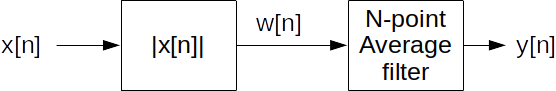

2.1 Define a function `envelope(x, N)` which applies an N-point averaging filter to the full-wave rectified signal and returns the output $y[n]$. 

**Note 1**: to calculate the full-wave rectified signal check the `np.abs()` function.

**Note 2**: The output should have the same length as the input signal. Use 'same' mode (see [np.convolve](https://numpy.org/doc/stable/reference/generated/numpy.convolve.html) documentation).

In [ ]:
   """Extracts the envelope of the input signal x

   Parameters
   ----------
    x : np.array
        The input signal in the form of a numpy array
    N : int
        The number of points used in N-point averaging filter

    Returns
    -------
    y : np.array
        The output of the system, i.e the envelope of the signal x.

   """

def envelope(x, N):
  abs_x = np.abs(x)
  y = averaging_filter(abs_x, N, "valid")
  return y 
  

2.2 Load your reference signal and calculate its envelope using the function you designed. Plot the reference signal and envelope in the same figure.

In [ ]:
!git clone https://github.com/JamesBedsonUPF/sis1_group9.git
filepath = "./sis1_group9/HarpSound.wav"
ref, fs = load_audio(filepath)

fatal: destination path 'sis1_group9' already exists and is not an empty directory.


In [ ]:
plot_signals([ref, envelope(ref, 500)], fs, name=['ref x[n]', 'envelope y[n]'])

2.3 Change the number N to get a good result. What happens when you change the number N?

If we choose N to be a low value (1-50) the envelope takes on the shape of the positive part of the reference signal (as a lot of the high frequency information is still present). For values of N between 100 and 500, we get a relatively clean representation of the signal's envelope. For values of N above 500, the averager averages too much and we start to lose the shape.

2.4 Explain with your own words why this system achieves extracting the envelope. It might be useful to plot together the signals $x[n]$, $w[n]$ and $y[n]$.

In [ ]:
plot_signals([ref, np.abs(ref), envelope(ref, 500)], fs, name=['ref x[n]', 'absolute x w[n]', 'envelope y[n]'])

The envelope consists of two parts. One the one hand we have $w[n]$ which represents only the positive part of our signal. At this stage, $w[n]$ contains all of the same frequency information as the reference signal $x[n]$. Once we apply the filter, we get only the averaged part of $w[n]$, which is to say that we lose most of the higher frequencies, resulting in a smooth signal that represents the envelope of $x[n]$.


2.5 Now let's apply this envelope to the synthesized signal. Copy the code from Lab3 Ex. 2.1 and generate the synthesized signal. Then multiply the synthesized signal by the envelope. Note that both signal and envelope should have the same length. You can define a time vector of the same length of the envelope to create the signal: 

In [ ]:
def synthesize(f0, phi, Ak, t):
  y = 0
  for k in range(1, len(Ak) + 1):
    y += Ak[k-1] * np.cos(2*np.pi*k*f0*t + k*phi - (k-1)*np.pi/2)
  return y

In [ ]:
envelope_signal = envelope(ref, 500)
Ts = 1/float(fs)
t = np.arange(0, len(envelope_signal)*Ts, Ts)
t1 = 0.1004771
frequency = 1071.277
period = 1 / frequency
start = 0.1
rad_frequency = 2 * np.pi * frequency
our_phi = - rad_frequency * t1
weights = [1, 0.11245, 0.008772, 0.01561, 0.001569, 0.0012267, 0.000644, 0.0006886015, 0.000566, 0.000487, 0.000531]
synthesized_signal = synthesize(frequency, our_phi, weights, t)
#synthesized_signal = (weights[1] * synthesized_signal-0.001) / np.amax(synthesized_signal)

multiplied = synthesized_signal[:-1] * envelope_signal

2.5. Compare the spectrograms of the reference signal and the synthesized signal. What are the main differences? 

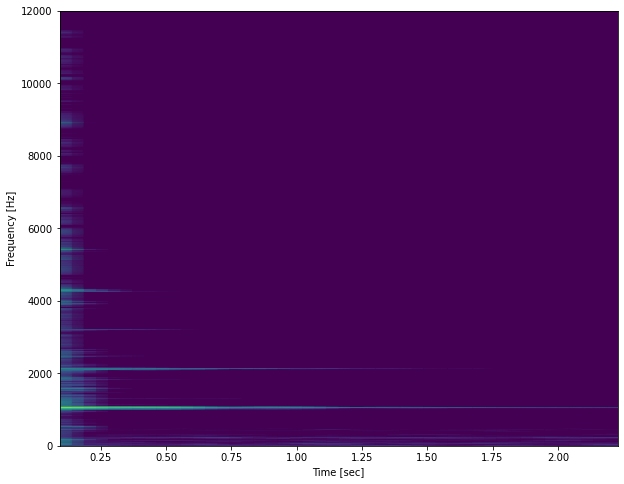

In [ ]:
window_length = 8192
ff, tt, S = signal.spectrogram(ref, fs, nperseg=window_length, noverlap=window_length/2)

plt.figure(figsize=(10,8))
plot_spectrogram(ff, tt, S)
plt.ylim([0, 12000])
plt.show()

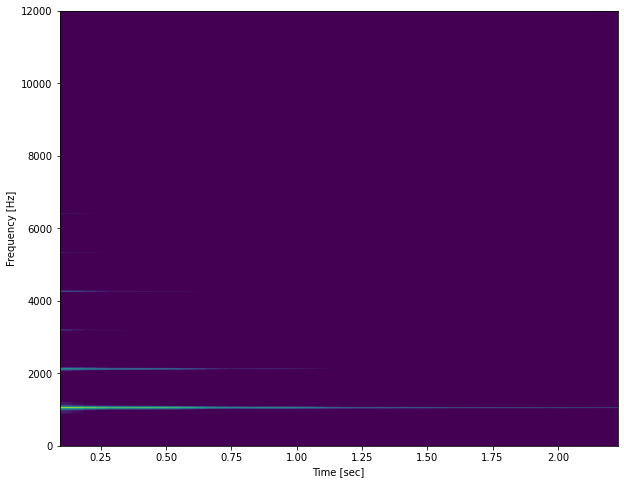

In [ ]:
window_length = 8192
ff, tt, S = signal.spectrogram(multiplied, fs, nperseg=window_length, noverlap=window_length/2)

plt.figure(figsize=(10,8))
plot_spectrogram(ff, tt, S)
plt.ylim([0, 12000])
plt.show()

The main difference is the missing frequency components of the reference signal (which could be noise, harmonics we missed in the last lab, etc.). 

2.6 Listen to the synthesized signal and compare it to the reference.



In [ ]:
ipd.Audio(multiplied, rate=fs)

In [ ]:
ipd.Audio(ref, rate=fs)

The synthesized signal is a lot more similar to the reference signal. Applying the envelope, we have simulated the same changes in amplitude. However, in order to get an even better result, we would have to find a way to recreate the attack of the reference signal (i.e. the "pluck").